In [1]:
import os
import shutil
import socket
from pathlib import Path
import cv2
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd


## Dataset location

In [2]:
hostname = socket.gethostname()
if hostname == "HAITI":
    # repo_folder = "C:/Users/xin/OneDrive - bwstaff/xin/yolov5/"
    dataset_folder = "D:/xin/datasets/CV/kitti/"
    # dataset_folder = "C:/Users/xin/Downloads/kitti"
if hostname == "BALI":
    # repo_folder = "/home//OneDrive/xin/yolov5/"
    dataset_folder = "/storage/xin/datasets/CV/kitti/"
    dataset_folder = "/home/xin/Datasets/kitti"
if hostname == "DESKTOP-SJ7KPPD":
    # repo_folder = "C:/Users/Xin/OneDrive - bwstaff/xin/yolov5/"
    # repo_folder = "C:/Users/Xin/git_repo_local/yolov5_local/"
    dataset_folder = "C:/Users/Xin/Datasets/kitti"
if hostname == "chen-Ubuntu":
    # repo_folder = "C:/Users/Xin/OneDrive - bwstaff/xin/yolov5/"
    # repo_folder = "C:/Users/Xin/git_repo_local/yolov5_local/"
    dataset_folder = ".."

# repo_folder = Path(repo_folder)
dataset_folder = Path(dataset_folder)
dataset_source_folder = dataset_folder / "Source"  # original downloaded dataset is here


## utils

In [3]:
class Colors:
    # Ultralytics color palette https://ultralytics.com/
    def __init__(self):
        # hex = matplotlib.colors.TABLEAU_COLORS.values()
        hexs = (
            "FF3838",
            "FF9D97",
            "FF701F",
            "FFB21D",
            "CFD231",
            "48F90A",
            "92CC17",
            "3DDB86",
            "1A9334",
            "00D4BB",
            "2C99A8",
            "00C2FF",
            "344593",
            "6473FF",
            "0018EC",
            "8438FF",
            "520085",
            "CB38FF",
            "FF95C8",
            "FF37C7",
        )
        self.palette = [self.hex2rgb(f"#{c}") for c in hexs]
        self.n = len(self.palette)

    def __call__(self, i, bgr=False):
        c = self.palette[int(i) % self.n]
        return (c[2], c[1], c[0]) if bgr else c

    @staticmethod
    def hex2rgb(h):  # rgb order (PIL)
        return tuple(int(h[1 + i : 1 + i + 2], 16) for i in (0, 2, 4))


colors = Colors()


## Train/Val/Test split

In [4]:
def walk_through_dir(dir_path):
    """
    Walks through dir_path returning its contents.
    Args:
      dir_path (str or pathlib.Path): target directory

    Returns:
      A print out of:
        number of subdiretories in dir_path
        number of images (files) in each subdirectory
        name of each subdirectory
    """
    for dirpath, dirnames, filenames in os.walk(dir_path):
        print(
            f"There are {len(dirnames)} directories and {len(filenames)} images in '{dirpath}'."
        )


In [5]:
walk_through_dir(dataset_source_folder)


There are 3 directories and 0 images in '../Source'.
There are 3 directories and 1 images in '../Source/devkit_object'.
There are 0 directories and 3 images in '../Source/devkit_object/cpp'.
There are 0 directories and 2 images in '../Source/devkit_object/mapping'.
There are 0 directories and 12 images in '../Source/devkit_object/matlab'.
There are 3 directories and 0 images in '../Source/testing'.
There are 0 directories and 7518 images in '../Source/testing/calib'.
There are 0 directories and 7518 images in '../Source/testing/image_2'.
There are 0 directories and 7518 images in '../Source/testing/velodyne'.
There are 4 directories and 0 images in '../Source/training'.
There are 0 directories and 7481 images in '../Source/training/calib'.
There are 0 directories and 7481 images in '../Source/training/image_2'.
There are 0 directories and 7481 images in '../Source/training/label_2'.
There are 0 directories and 7481 images in '../Source/training/velodyne'.


In [6]:
# source image paths
src_training_folder = dataset_source_folder / "training"
src_training_image_folder = src_training_folder / "image_2"
src_training_image_path_list = sorted(list(src_training_image_folder.glob("**/*.png")))

src_training_label_folder = src_training_folder / "label_2"
src_training_label_path_list = sorted(list(src_training_label_folder.glob("**/*.txt")))


## show images

In [7]:
cls_names = [
    "Pedestrian",
    "Car",
    "Van",
    "Truck",
    "Person_sitting",
    "Cyclist",
    "Tram",
    "Misc",
    "DontCare",
]
cls_dict = {n: i for i, n in enumerate(cls_names)}


In [8]:
def observe(
    num,
    image_list=src_training_image_path_list,
    label_list=src_training_label_path_list,
    xyxy=True,
):
    image = image_list[num]
    label = label_list[num]
    print(image)
    print(label)
    img = cv2.imread(str(image))
    height, width, channels = img.shape
    print(height, width, channels)
    with open(label) as f:
        lines = f.readlines()
    for line in lines:
        line = line.split()
        print(line)
        if xyxy:
            # kitti originally records top-left and bottom-right coordinates
            n = int(cls_dict[line[0]])
            xyxy = [int(float(x)) for x in line[4:8]]  # TODO: 为什么bounding box是小数
            cv2.rectangle(
                img,
                tuple(xyxy[0:2]),
                tuple(xyxy[2:4]),
                color=colors(n, True),
                thickness=5,
            )
        else:
            # xywh and in yolo format
            n = int(line[0])
            xc = int(width * float(line[1]))
            yc = int(height * float(line[2]))
            w = int(width * float(line[3]))
            h = int(height * float(line[4]))
            cv2.rectangle(
                img,
                (xc - w // 2, yc - h // 2),
                (xc + w // 2, yc + h // 2),
                color=colors(n, True),
                thickness=5,
            )

    plt.figure(figsize=(int(10 * width / height), 10))
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))


../Source/training/image_2/000000.png
../Source/training/label_2/000000.txt
370 1224 3
['Pedestrian', '0.00', '0', '-0.20', '712.40', '143.00', '810.73', '307.92', '1.89', '0.48', '1.20', '1.84', '1.47', '8.41', '0.01']


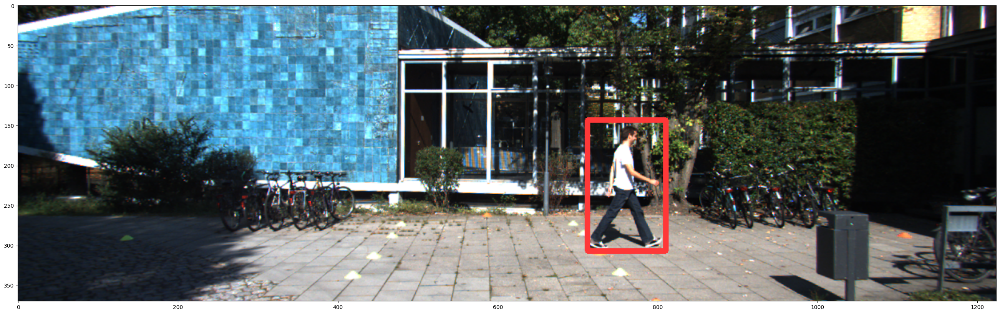

In [9]:
observe(0)


../Source/training/image_2/001000.png
../Source/training/label_2/001000.txt
375 1242 3
['Car', '0.00', '0', '2.69', '798.93', '169.95', '1060.55', '250.42', '1.47', '1.77', '4.49', '6.27', '1.45', '14.55', '3.09']
['Car', '0.00', '0', '-1.62', '561.02', '184.64', '587.94', '208.40', '1.52', '1.62', '4.50', '-2.50', '2.35', '49.56', '-1.67']
['Car', '0.00', '0', '1.68', '468.53', '187.25', '501.75', '210.97', '1.42', '1.66', '4.50', '-8.15', '2.39', '47.26', '1.51']
['DontCare', '-1', '-1', '-10', '507.62', '178.59', '543.49', '204.76', '-1', '-1', '-1', '-1000', '-1000', '-1000', '-10']


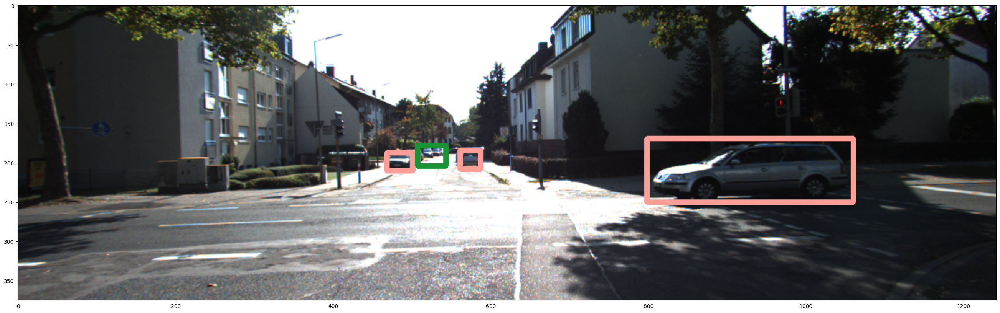

In [10]:
observe(1000)


## Dataset Classes

In [11]:
person_list = (
    []
)  # squash 'Pedestrian', 'Person_sitting', 'Cyclist' into one Person class
vehicle_list = []  # squash 'Car', 'Van', 'Truck', 'Tram' into one Vehicle class
misc_list = []
dontcare_list = []

for i, label_path in enumerate(src_training_label_path_list):
    with open(label_path) as f:
        lines = f.readlines()
        for line in lines:
            line = line.split()
            if line[0] == "DontCare":
                dontcare_list.append(i)
            elif line[0] == "Misc":
                misc_list.append(i)
            elif line[0] in ["Pedestrian", "Person_sitting", "Cyclist"]:
                person_list.append(i)
            elif line[0] in ["Car", "Van", "Truck", "Tram"]:
                vehicle_list.append(i)
print(f"There are {len(person_list)} images with Person labels.")
print(f"There are {len(vehicle_list)} images with Vehicle labels.")
print(f"There are {len(dontcare_list)} images with DontCare labels.")
print(f"There are {len(misc_list)} images with Misc labels.")


There are 6336 images with Person labels.
There are 33261 images with Vehicle labels.
There are 11295 images with DontCare labels.
There are 973 images with Misc labels.


### Misc and DontCare

../Source/training/image_2/000002.png
../Source/training/label_2/000002.txt
375 1242 3
['Misc', '0.00', '0', '-1.82', '804.79', '167.34', '995.43', '327.94', '1.63', '1.48', '2.37', '3.23', '1.59', '8.55', '-1.47']
['Car', '0.00', '0', '-1.67', '657.39', '190.13', '700.07', '223.39', '1.41', '1.58', '4.36', '3.18', '2.27', '34.38', '-1.58']


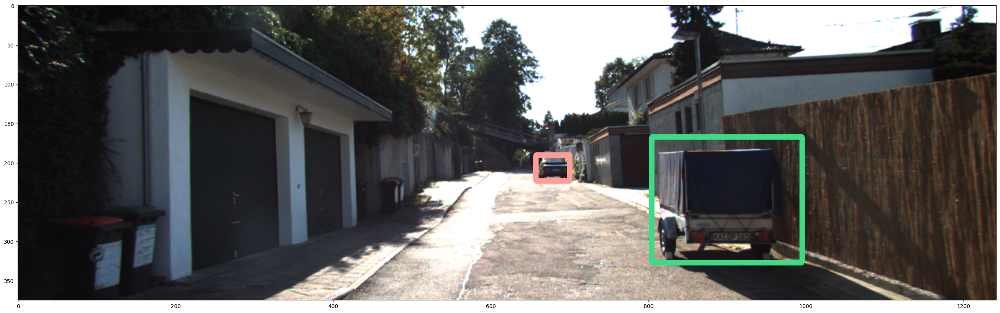

In [12]:
observe(misc_list[0])


C:\Users\Xin\Datasets\kitti\Source\training\image_2\000705.png
C:\Users\Xin\Datasets\kitti\Source\training\label_2\000705.txt
375 1242 3
['Car', '0.00', '0', '-1.56', '597.05', '174.63', '657.08', '232.64', '1.61', '1.66', '3.20', '0.48', '1.68', '21.82', '-1.54']
['Car', '0.00', '1', '-1.73', '705.10', '180.22', '778.38', '234.96', '1.43', '1.50', '3.38', '3.66', '1.65', '20.73', '-1.56']
['Misc', '0.00', '0', '-1.93', '934.20', '147.72', '969.79', '186.23', '2.18', '1.30', '1.75', '19.86', '0.76', '41.98', '-1.49']
['Pedestrian', '0.00', '0', '2.92', '722.18', '171.65', '738.93', '235.03', '1.63', '0.41', '0.33', '3.11', '1.61', '18.84', '3.08']
['Car', '0.00', '1', '-2.14', '1049.15', '163.93', '1160.31', '202.47', '1.41', '1.69', '4.10', '19.58', '1.11', '28.83', '-1.54']
['Car', '0.38', '0', '-2.24', '1149.16', '147.88', '1241.00', '208.62', '1.80', '1.67', '3.62', '19.43', '1.07', '23.13', '-1.55']


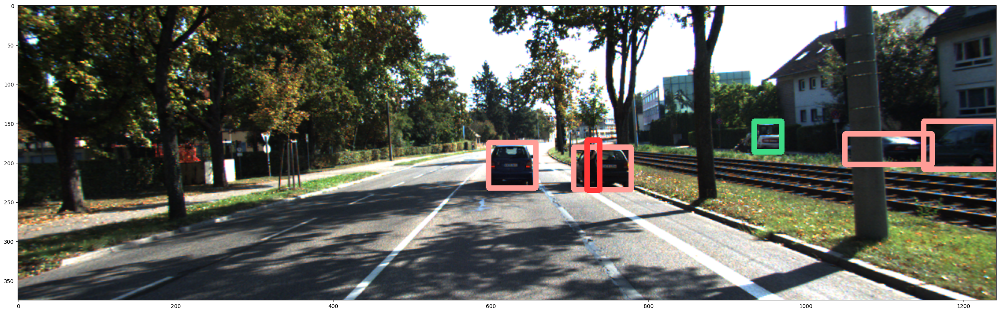

In [77]:
observe(misc_list[100])


## depth

In [13]:
ds = []
for i, label_path in enumerate(src_training_label_path_list):
    with open(label_path) as f:
        lines = f.readlines()
        for line in lines:
            line = line.split()
            if line[0] == "DontCare":
                continue
            d = float(line[13])
            if d < 0:
                print(f"negative depth at {i}")
            ds.append(d)


negative depth at 301
negative depth at 1628
negative depth at 2465
negative depth at 2520
negative depth at 3216
negative depth at 3396
negative depth at 4825
negative depth at 5029


array([[<AxesSubplot: title={'center': '0'}>]], dtype=object)

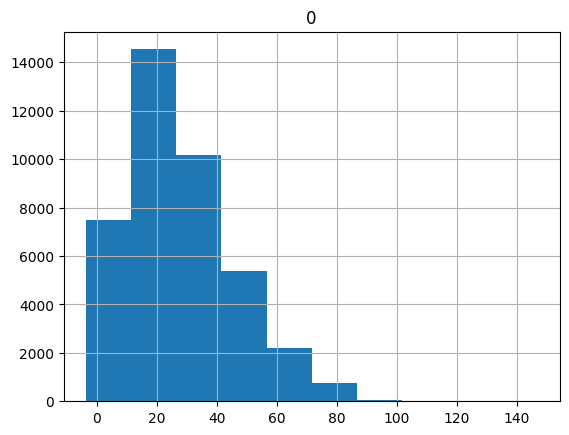

In [14]:
# describe depths in kitti
df = pd.DataFrame(ds)
df.hist(bins=10)


In [15]:
df.describe()

,0
count,40570.000000
mean,27.908786
std,17.440432
min,-3.550000
25%,14.200000
50%,24.520000
75%,38.327500
max,146.850000


In [28]:
perc_g_100 = ((df>100).sum()/df.shape[0]).values[0]
perc_g_80 = ((df>80).sum()/df.shape[0]).values[0]
print(f'Only {perc_g_100:.2%} of the depths are greater than 100m.')
print(f'Only {perc_g_80:.2%} of the depths are greater than 80m.')

Only 0.05% of the depths are greater than 100m.
Only 0.38% of the depths are greater than 80m.


../Source/training/image_2/000301.png
../Source/training/label_2/000301.txt
376 1241 3
['Car', '0.00', '0', '-1.57', '553.85', '173.51', '628.19', '241.31', '1.60', '1.76', '3.84', '-0.48', '1.32', '19.08', '-1.59']
['Truck', '1.00', '0', '-0.04', '25.62', '0.00', '401.93', '375.00', '4.05', '2.50', '16.44', '-3.53', '1.58', '-0.16', '-1.58']
['Car', '0.00', '1', '-1.36', '358.80', '191.12', '496.37', '276.59', '1.30', '1.61', '4.39', '-3.29', '1.45', '13.79', '-1.59']
['Car', '0.00', '1', '-1.41', '442.41', '179.69', '525.35', '236.97', '1.46', '1.66', '4.29', '-3.46', '1.31', '20.58', '-1.58']
['Car', '0.00', '1', '-1.45', '485.90', '173.99', '543.29', '220.87', '1.65', '1.70', '3.90', '-3.50', '1.24', '27.40', '-1.58']
['Car', '0.00', '2', '-1.35', '409.78', '174.99', '462.77', '212.30', '1.66', '1.62', '3.95', '-8.12', '1.20', '34.23', '-1.59']
['Car', '0.00', '1', '-1.49', '517.51', '175.34', '558.56', '209.96', '1.64', '1.72', '4.24', '-3.51', '1.16', '36.56', '-1.58']


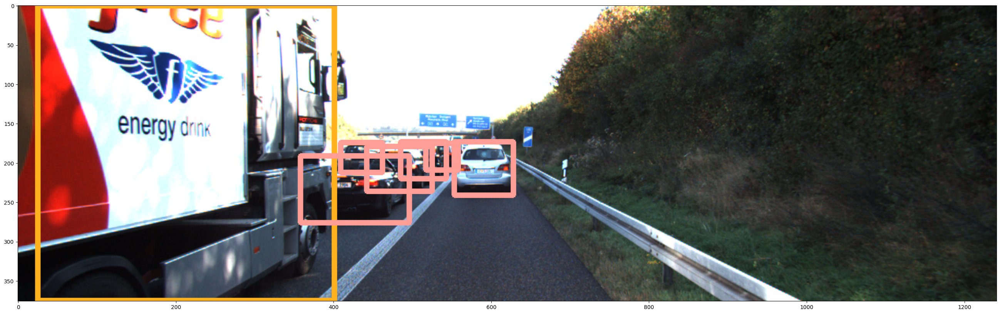

In [16]:
# oberve one negative depth
observe(301)


C:\Users\Xin\Datasets\kitti\Source\training\image_2\005029.png
C:\Users\Xin\Datasets\kitti\Source\training\label_2\005029.txt
375 1242 3
['Car', '1.00', '0', '3.11', '1232.81', '169.09', '1241.00', '374.00', '1.52', '1.58', '4.28', '2.55', '1.48', '-0.18', '-1.64']
['Car', '0.00', '0', '1.97', '334.99', '181.05', '563.89', '319.67', '1.54', '1.64', '4.08', '-2.04', '1.67', '10.26', '1.77']
['Car', '0.64', '0', '-1.93', '839.76', '195.34', '1241.00', '374.00', '1.46', '1.57', '3.58', '2.70', '1.66', '4.93', '-1.45']
['Car', '0.00', '1', '-1.83', '793.62', '178.45', '1013.17', '329.15', '1.58', '1.67', '3.43', '3.49', '1.67', '9.35', '-1.49']
['Car', '0.61', '1', '-2.53', '1141.66', '144.36', '1241.00', '225.04', '1.84', '1.94', '3.68', '15.14', '1.19', '17.13', '-1.82']
['Van', '0.00', '1', '-2.36', '1031.43', '137.21', '1234.52', '232.95', '2.04', '1.72', '3.79', '12.32', '1.29', '17.36', '-1.75']
['Van', '0.00', '1', '-2.18', '916.34', '149.56', '1092.21', '234.60', '1.86', '1.75', '4

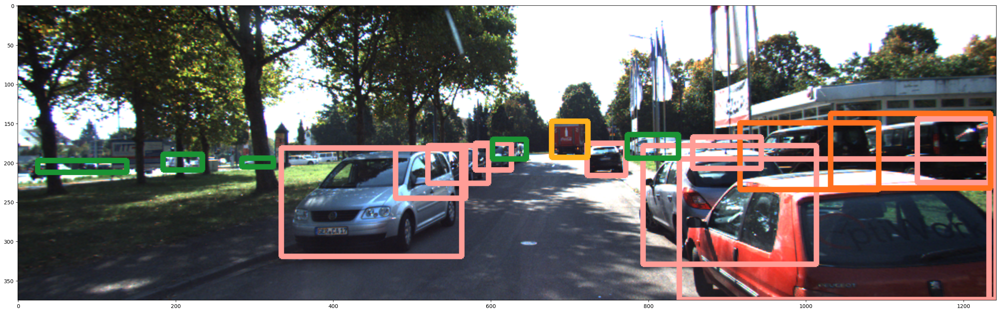

In [68]:
# oberve another negative depth
observe(5029)


## Generate kitti128_depth
1. randomly choose 128 images for training and val respectively
2. squash all classes into two classes: 'Person' and 'Vehicle'
3. transform labels to yolo format
4. copy images and labels to corresponding folders according to the requirement of yolo

In [17]:
# step 1: randomly choose 128 images for training and val respectively
import random

random.seed(42)
mask = random.sample(range(len(src_training_image_path_list)), 256)
kitti128_training_image_list = sorted(
    [src_training_image_path_list[i] for i in mask[:128]]
)
kitti128_training_label_list = sorted(
    [src_training_label_path_list[i] for i in mask[:128]]
)
kitti128_val_image_list = sorted([src_training_image_path_list[i] for i in mask[128:]])
kitti128_val_label_list = sorted([src_training_label_path_list[i] for i in mask[128:]])


In [18]:
# step 2: squash all classes into two classes: 'Person' and 'Vehicle'

cls_names = [
    "Pedestrian",
    "Car",
    "Van",
    "Truck",
    "Person_sitting",
    "Cyclist",
    "Tram",
    "Misc",
    "DontCare",
]

classes = ["Person", "Vehicle"]
classes_dict = {
    "Pedestrian": 0,
    "Person_sitting": 0,
    "Cyclist": 0,
    "Car": 1,
    "Van": 1,
    "Truck": 1,
    "Tram": 1,
}


In [19]:
# step 3: transform kitti128 dataset into yolo format


def txt_kitti2yolo(image_path_list, label_path_list):
    """
    Args:
        image_path: path list to images
        label_path: path list to labels
        xyxy: True if label is in xyxy format, False if label is in xywh format

    Return:
        txt_list: LIST of list of strings,
                    each string is A line in txt file
                    each item in list is ALL lines of txt file
                    each item in LIST is a list of strings extracted form ONE txt file
    """
    txt_list = []

    for image_path, label_path in zip(image_path_list, label_path_list):
        with open(label_path) as f:
            lines = f.readlines()
            lines = [line.split() for line in lines]

            # # if not in classes, skip
            # if not any([line[0] in classes for line in lines]):
            #     continue

            # to store labels for one file
            txt_temp = []

            # read image info
            img = cv2.imread(str(image_path))
            height, width, channels = img.shape

            # deal with each line in label file
            for line in lines:
                if (
                    line[0] == "DontCare" or line[0] == "Misc"
                ):  # TODO: Is this the best way to deal with 'DontCare' and 'Misc'?
                    continue
                # kitti originally records top-left and bottom-right coordinates
                # but coco records center and size
                c = int(classes_dict[line[0]])
                x0 = float(line[4]) / width
                y0 = float(line[5]) / height
                x1 = float(line[6]) / width
                y1 = float(line[7]) / height

                # preprocessing for depth
                # TODO: is it the best way?
                # clip negative depth to zero, so that depths are in [0, 146.85]
                d = max(0, float(line[13]))
                # change to [0, 1] by dividing 146.85
                # d /= 146.85

                # xyxy to xywh
                w = x1 - x0
                h = y1 - y0
                xc = (x0 + x1) / 2
                yc = (y0 + y1) / 2

                # keep 6 digits as in coco
                w = round(w, 6)
                h = round(h, 6)
                xc = round(xc, 6)
                yc = round(yc, 6)
                d = round(d, 6)

                # append to txt_temp
                txt_temp.append(f"{c} {xc} {yc} {w} {h} {d}")
            if len(txt_temp) == []:
                print(f"no interesting label in {label_path}")
            # save new txt
            txt_list.append(txt_temp)
    return txt_list


train_txt_list = txt_kitti2yolo(
    kitti128_training_image_list, kitti128_training_label_list
)
val_txt_list = txt_kitti2yolo(kitti128_val_image_list, kitti128_val_label_list)


../Source/training/image_2/000244.png
../Source/training/label_2/000244.txt
375 1242 3
['Car', '0.78', '0', '2.08', '0.00', '183.99', '421.32', '374.00', '1.63', '1.60', '3.73', '-2.51', '1.71', '4.36', '1.59']
['Car', '0.99', '0', '-2.38', '948.87', '191.74', '1241.00', '374.00', '1.59', '1.49', '3.34', '2.63', '1.69', '2.33', '-1.60']
['Car', '0.07', '0', '-1.86', '730.11', '191.65', '1000.19', '374.00', '1.54', '1.60', '3.52', '2.35', '1.77', '7.71', '-1.58']
['Car', '0.00', '2', '-1.35', '307.67', '188.31', '487.75', '335.88', '1.54', '1.50', '3.48', '-2.64', '1.77', '9.56', '-1.62']
['Car', '0.00', '2', '1.75', '410.78', '188.92', '522.89', '272.41', '1.44', '1.63', '3.32', '-2.82', '1.80', '14.63', '1.56']
['Car', '0.00', '2', '-1.82', '685.04', '181.86', '806.70', '271.17', '1.55', '1.55', '3.27', '2.53', '1.74', '14.37', '-1.65']
['Car', '0.00', '2', '-1.70', '656.44', '183.23', '735.82', '245.57', '1.48', '1.60', '3.79', '2.18', '1.78', '19.43', '-1.59']
['Car', '0.00', '1', '

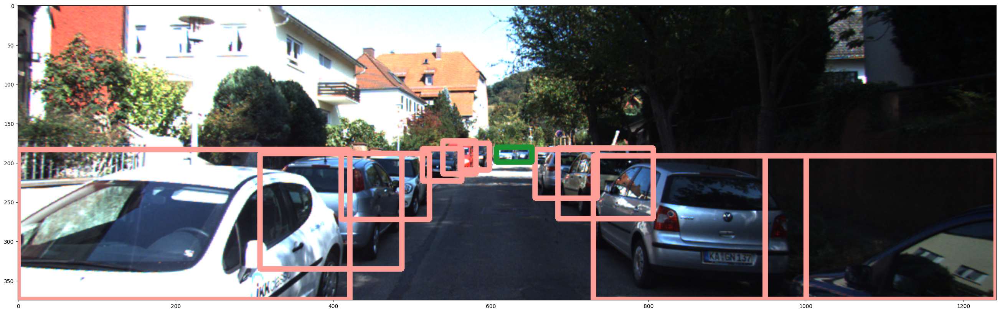

In [20]:
# check one out
num = 3
observe(num, kitti128_training_image_list, kitti128_training_label_list)

# print out its txt
print("txt in yolo format:")
for line in train_txt_list[num]:
    print(line)


In [21]:
# step 4: copy images and labels to new folders


def copy_paste_image(path_list, dst):
    """
    Copies files from path_list to dst.
    Args:
      path_list list: list of paths to copy
      dst pathlib.Path: destination folder
    """
    if dst.is_dir():
        print(f"Directory {dst} already exists.")
        print("Nothing done.")
    else:
        # print(f"Did not find {dst} directory.")
        dst.mkdir(parents=True, exist_ok=True)
        print(f"Directory {dst} created.")
        print(f"Copying files to {dst}...")
        for file in path_list:
            shutil.copy(file, dst)
        print("Done.")


def copy_paste_label(path_list, txt_list, dst):
    """
    Copies files from path_list, to dst.
    Args:
      path_list list: list of paths of source label
      txt_list list: list of actual labels to copy
      dst pathlib.Path: destination folder
    """
    if dst.is_dir():
        print(f"Directory {dst} already exists.")
        print("Nothing done.")
    else:
        # print(f"Did not find {dst} directory.")
        dst.mkdir(parents=True, exist_ok=True)
        print(f"Directory {dst} created.")
        print(f"Copying files to {dst}...")

        for i, file in enumerate(path_list):
            # create new label file
            label_file = dst / file.name
            with open(label_file, "w") as f:
                for line in txt_list[i]:
                    f.write(line + "\n")
        print("Done.")


In [22]:
kitti128_folder = dataset_folder / "kitti128_depth"
image_dir = kitti128_folder / "images"
label_dir = kitti128_folder / "labels"

copy_paste_image(kitti128_training_image_list, image_dir / "train")
copy_paste_image(kitti128_val_image_list, image_dir / "val")
copy_paste_label(kitti128_training_label_list, train_txt_list, label_dir / "train")
copy_paste_label(kitti128_val_label_list, val_txt_list, label_dir / "val")


Directory ../kitti128_depth/images/train created.
Copying files to ../kitti128_depth/images/train...
Done.
Directory ../kitti128_depth/images/val created.
Copying files to ../kitti128_depth/images/val...
Done.
Directory ../kitti128_depth/labels/train created.
Copying files to ../kitti128_depth/labels/train...
Done.
Directory ../kitti128_depth/labels/val created.
Copying files to ../kitti128_depth/labels/val...
Done.


## Show image with xywh

In [32]:
kitti128_folder = dataset_folder / "kitti128_depth"
image_dir = kitti128_folder / "images"
label_dir = kitti128_folder / "labels"

classes = ["Person", "Vehicle"]
classes_dict_inv = {i: c for i, c in enumerate(classes)}

target_image_path_list = sorted(list(Path(image_dir / "train").glob("**/*.png")))
target_label_path_list = sorted(list(Path(label_dir / "train").glob("**/*.txt")))


../kitti128_depth/images/train/000244.png
../kitti128_depth/labels/train/000244.txt
375 1242 3
['1', '0.169614', '0.743987', '0.339227', '0.506693', '4.36']
['1', '0.88159', '0.75432', '0.235209', '0.486027', '2.33']
['1', '0.696578', '0.7542', '0.217456', '0.486267', '7.71']
['1', '0.320217', '0.69892', '0.144992', '0.39352', '9.56']
['1', '0.375874', '0.615107', '0.090266', '0.22264', '14.63']
['1', '0.600539', '0.60404', '0.097955', '0.23816', '14.37']
['1', '0.560491', '0.571733', '0.063913', '0.16624', '19.43']
['1', '0.433583', '0.541453', '0.03971', '0.108293', '29.97']
['1', '0.451385', '0.515613', '0.033752', '0.110693', '35.51']
['1', '0.467114', '0.514147', '0.030089', '0.089947', '41.52']


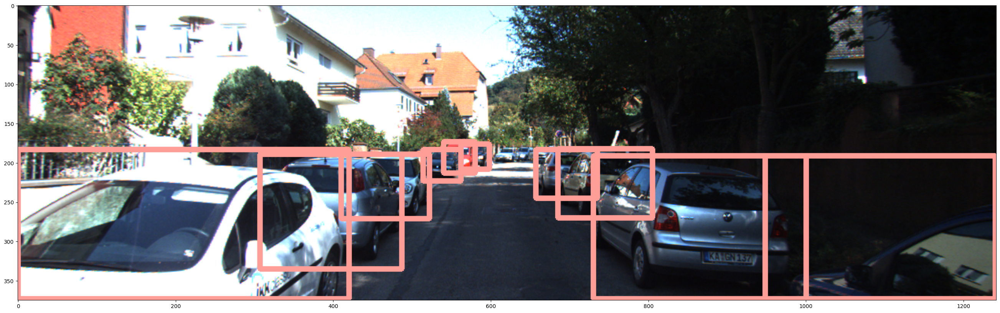

In [33]:
# show the same image but in yolo format
observe(
    num=3,
    image_list=target_image_path_list,
    label_list=target_label_path_list,
    xyxy=False,
)


## show depth in image

In [34]:
import torch
import threading
import math


In [35]:
def xyxy2xywh(x):
    # Convert nx4 boxes from [x1, y1, x2, y2] to [x, y, w, h] where xy1=top-left, xy2=bottom-right
    y = x.clone() if isinstance(x, torch.Tensor) else np.copy(x)
    y[:, 0] = (x[:, 0] + x[:, 2]) / 2  # x center
    y[:, 1] = (x[:, 1] + x[:, 3]) / 2  # y center
    y[:, 2] = x[:, 2] - x[:, 0]  # width
    y[:, 3] = x[:, 3] - x[:, 1]  # height
    return y


def xywh2xyxy(x):
    # Convert nx4 boxes from [x, y, w, h] to [x1, y1, x2, y2] where xy1=top-left, xy2=bottom-right
    y = x.clone() if isinstance(x, torch.Tensor) else np.copy(x)
    y[:, 0] = x[:, 0] - x[:, 2] / 2  # top left x
    y[:, 1] = x[:, 1] - x[:, 3] / 2  # top left y
    y[:, 2] = x[:, 0] + x[:, 2] / 2  # bottom right x
    y[:, 3] = x[:, 1] + x[:, 3] / 2  # bottom right y
    return y


def output_to_target(output, max_det=300):
    # Convert model output to target format [batch_id, class_id, x, y, w, h, conf] for plotting
    targets = []
    for i, o in enumerate(output):
        if o.shape[1] == 6:  # without depth
            box, conf, cls = o[:max_det, :6].cpu().split((4, 1, 1), 1)
            j = torch.full((conf.shape[0], 1), i)
            targets.append(torch.cat((j, cls, xyxy2xywh(box), conf), 1))
        if o.shape[1] == 7:  # for depth
            box, conf, cls, depth = o[:max_det, :7].cpu().split((4, 1, 1, 1), 1)
            j = torch.full((conf.shape[0], 1), i)
            targets.append(torch.cat((j, cls, xyxy2xywh(box), conf, depth), 1))
    return torch.cat(targets, 0).numpy()


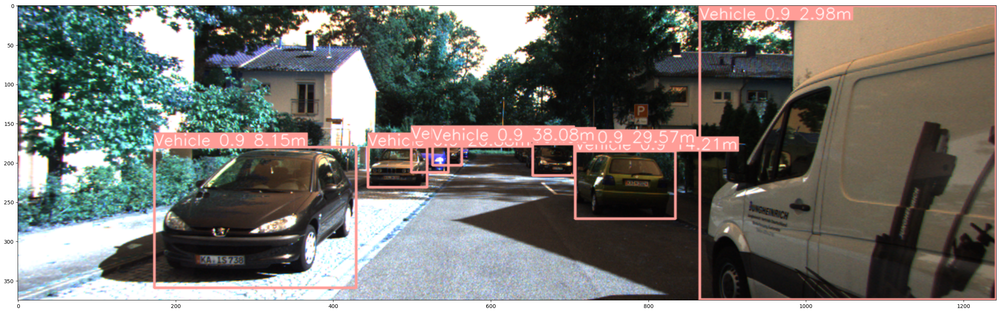

In [36]:
def box_label(im, box, label, color=(255, 0, 0), txt_color=(255, 255, 255)):
    lw = max(round(sum(im.shape) / 2 * 0.003), 2)

    p1, p2 = (int(box[0]), int(box[1])), (int(box[2]), int(box[3]))
    cv2.rectangle(im, p1, p2, color, thickness=lw, lineType=cv2.LINE_AA)
    if label:
        tf = max(lw - 1, 1)  # font thickness
        w, h = cv2.getTextSize(label, 0, fontScale=lw / 3, thickness=tf)[
            0
        ]  # text width, height
        outside = p1[1] - h >= 3
        p2 = p1[0] + w, p1[1] - h - 3 if outside else p1[1] + h + 3
        cv2.rectangle(im, p1, p2, color, -1, cv2.LINE_AA)  # filled
        cv2.putText(
            im,
            label,
            (p1[0], p1[1] - 2 if outside else p1[1] + h + 2),
            0,
            lw / 3,
            txt_color,
            thickness=tf,
            lineType=cv2.LINE_AA,
        )


num = 0
img = cv2.imread(str(target_image_path_list[num]))
h, w, _ = img.shape
label_path = target_label_path_list[num]
with open(label_path) as f:
    targets = f.readlines()
targets = [line.split() for line in targets]
for target in targets:
    # extract box in xywh
    box = [float(x) for x in target[1:5]]
    # convert to xyxy
    box = xywh2xyxy(np.array(box)[None])[0]
    # convert to pixel
    box = box * np.array([w, h, w, h])
    # extract depth
    depth = float(target[5])
    # extract label
    c = int(target[0])
    color = colors(c)
    label = classes_dict_inv[c]

    # add fake conf
    label = label + " " + "0.9"

    # add depth
    # d = round(float(target[-1])*146.85,2)
    d = round(float(target[-1]), 2)
    label = label + " " + str(d) + "m"

    # draw for this line
    box_label(img, box, label, color)
plt.figure(figsize=(int(10 * w / h), 10))
plt.imshow(img)


In [37]:
# gt in format [cls, x, y, w, h, depth]
for target in targets:
    print(target)


['1', '0.847919', '0.498667', '0.302552', '0.997333', '2.98']
['1', '0.242794', '0.721013', '0.206006', '0.477173', '8.15']
['1', '0.620785', '0.610187', '0.102214', '0.229013', '14.21']
['1', '0.388313', '0.548907', '0.060314', '0.13424', '20.88']
['1', '0.420837', '0.511547', '0.037858', '0.108853', '28.91']
['1', '0.547472', '0.52448', '0.042786', '0.107093', '29.57']
['1', '0.439002', '0.501667', '0.029469', '0.079547', '38.08']


In [38]:
def plot_images(images, targets, paths=None, fname="images.jpg", names=None):
    """used in val.py, 用于画保存在exp folder里的图片"""
    # Plot image grid with labels
    if isinstance(images, torch.Tensor):
        images = images.cpu().float().numpy()
    if isinstance(targets, torch.Tensor):
        targets = targets.cpu().numpy()

    max_size = 1920  # max image size
    max_subplots = 16  # max image subplots, i.e. 4x4
    bs, _, h, w = images.shape  # batch size, _, height, width
    bs = min(bs, max_subplots)  # limit plot images
    ns = np.ceil(bs**0.5)  # number of subplots (square)
    if np.max(images[0]) <= 1:
        images *= 255  # de-normalise (optional)

    # Build Image
    mosaic = np.full((int(ns * h), int(ns * w), 3), 255, dtype=np.uint8)  # init
    for i, im in enumerate(images):
        if i == max_subplots:  # if last batch has fewer images than we expect
            break
        x, y = int(w * (i // ns)), int(h * (i % ns))  # block origin
        im = im.transpose(1, 2, 0)
        mosaic[y : y + h, x : x + w, :] = im

    # Resize (optional)
    scale = max_size / ns / max(h, w)
    if scale < 1:
        h = math.ceil(scale * h)
        w = math.ceil(scale * w)
        mosaic = cv2.resize(mosaic, tuple(int(x * ns) for x in (w, h)))

    # Annotate
    fs = int((h + w) * ns * 0.01)  # font size
    annotator = Annotator(
        mosaic, line_width=round(fs / 10), font_size=fs, pil=True, example=names
    )
    for i in range(i + 1):
        x, y = int(w * (i // ns)), int(h * (i % ns))  # block origin
        annotator.rectangle(
            [x, y, x + w, y + h], None, (255, 255, 255), width=2
        )  # borders
        if paths:
            annotator.text(
                (x + 5, y + 5), text=Path(paths[i]).name[:40], txt_color=(220, 220, 220)
            )  # filenames
        if len(targets) > 0:
            ti = targets[targets[:, 0] == i]  # image targets
            boxes = xywh2xyxy(ti[:, 2:6]).T
            classes = ti[:, 1].astype("int")
            labels = ti.shape[1] == 6  # labels if no conf column
            conf = (
                None if labels else ti[:, 6]
            )  # check for confidence presence (label vs pred)

            if boxes.shape[1]:
                if boxes.max() <= 1.01:  # if normalized with tolerance 0.01
                    boxes[[0, 2]] *= w  # scale to pixels
                    boxes[[1, 3]] *= h
                elif scale < 1:  # absolute coords need scale if image scales
                    boxes *= scale
            boxes[[0, 2]] += x
            boxes[[1, 3]] += y
            for j, box in enumerate(boxes.T.tolist()):
                cls = classes[j]
                color = colors(cls)
                cls = names[cls] if names else cls
                if labels or conf[j] > 0.25:  # 0.25 conf thresh
                    label = f"{cls}" if labels else f"{cls} {conf[j]:.1f}"
                    annotator.box_label(box, label, color=color)
    annotator.im.save(fname)  # save


In [39]:
def observe(
    num,
    image_list=src_training_image_path_list,
    label_list=src_training_label_path_list,
    xyxy=True,
):
    image = image_list[num]
    label = label_list[num]
    print(image)
    print(label)
    img = cv2.imread(str(image))
    height, width, channels = img.shape
    print(height, width, channels)
    with open(label) as f:
        lines = f.readlines()
    for line in lines:
        line = line.split()
        print(line)
        if xyxy:
            # kitti originally records top-left and bottom-right coordinates
            n = int(cls_dict[line[0]])
            xyxy = [int(float(x)) for x in line[4:8]]  # TODO: 为什么bounding box是小数
            cv2.rectangle(
                img,
                tuple(xyxy[0:2]),
                tuple(xyxy[2:4]),
                color=colors(n, True),
                thickness=5,
            )
        else:
            # xywh and in yolo format
            n = int(line[0])
            xc = int(width * float(line[1]))
            yc = int(height * float(line[2]))
            w = int(width * float(line[3]))
            h = int(height * float(line[4]))
            cv2.rectangle(
                img,
                (xc - w // 2, yc - h // 2),
                (xc + w // 2, yc + h // 2),
                color=colors(n, True),
                thickness=5,
            )

    plt.figure(figsize=(int(10 * width / height), 10))
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))


In [31]:
class Annotator:
    # YOLOv5 Annotator for train/val mosaics and jpgs and detect/hub inference annotations
    def __init__(
        self,
        im,
        line_width=None,
        font_size=None,
        font="Arial.ttf",
        pil=False,
        example="abc",
    ):
        assert (
            im.data.contiguous
        ), "Image not contiguous. Apply np.ascontiguousarray(im) to Annotator() input images."
        non_ascii = not is_ascii(
            example
        )  # non-latin labels, i.e. asian, arabic, cyrillic
        self.pil = pil or non_ascii
        if self.pil:  # use PIL
            self.im = im if isinstance(im, Image.Image) else Image.fromarray(im)
            self.draw = ImageDraw.Draw(self.im)
            self.font = check_pil_font(
                font="Arial.Unicode.ttf" if non_ascii else font,
                size=font_size or max(round(sum(self.im.size) / 2 * 0.035), 12),
            )
        else:  # use cv2
            self.im = im
        self.lw = line_width or max(round(sum(im.shape) / 2 * 0.003), 2)  # line width

    def box_label(
        self, box, label="", color=(128, 128, 128), txt_color=(255, 255, 255)
    ):
        # Add one xyxy box to image with label
        if self.pil or not is_ascii(label):
            self.draw.rectangle(box, width=self.lw, outline=color)  # box
            if label:
                w, h = self.font.getsize(label)  # text width, height
                outside = box[1] - h >= 0  # label fits outside box
                self.draw.rectangle(
                    (
                        box[0],
                        box[1] - h if outside else box[1],
                        box[0] + w + 1,
                        box[1] + 1 if outside else box[1] + h + 1,
                    ),
                    fill=color,
                )
                # self.draw.text((box[0], box[1]), label, fill=txt_color, font=self.font, anchor='ls')  # for PIL>8.0
                self.draw.text(
                    (box[0], box[1] - h if outside else box[1]),
                    label,
                    fill=txt_color,
                    font=self.font,
                )
        else:  # cv2
            p1, p2 = (int(box[0]), int(box[1])), (int(box[2]), int(box[3]))
            cv2.rectangle(
                self.im, p1, p2, color, thickness=self.lw, lineType=cv2.LINE_AA
            )
            if label:
                tf = max(self.lw - 1, 1)  # font thickness
                w, h = cv2.getTextSize(label, 0, fontScale=self.lw / 3, thickness=tf)[
                    0
                ]  # text width, height
                outside = p1[1] - h >= 3
                p2 = p1[0] + w, p1[1] - h - 3 if outside else p1[1] + h + 3
                cv2.rectangle(self.im, p1, p2, color, -1, cv2.LINE_AA)  # filled
                cv2.putText(
                    self.im,
                    label,
                    (p1[0], p1[1] - 2 if outside else p1[1] + h + 2),
                    0,
                    self.lw / 3,
                    txt_color,
                    thickness=tf,
                    lineType=cv2.LINE_AA,
                )


In [ ]:
def threaded(func):
    # Multi-threads a target function and returns thread. Usage: @threaded decorator
    def wrapper(*args, **kwargs):
        thread = threading.Thread(target=func, args=args, kwargs=kwargs, daemon=True)
        thread.start()
        return thread

    return wrapper


@threaded
def plot_images(images, targets, paths=None, fname="images.jpg", names=None):
    """used in val.py, 用于画保存在exp folder里的图片"""
    # Plot image grid with labels
    if isinstance(images, torch.Tensor):
        images = images.cpu().float().numpy()
    if isinstance(targets, torch.Tensor):
        targets = targets.cpu().numpy()

    max_size = 1920  # max image size
    max_subplots = 16  # max image subplots, i.e. 4x4
    bs, _, h, w = images.shape  # batch size, _, height, width
    bs = min(bs, max_subplots)  # limit plot images
    ns = np.ceil(bs**0.5)  # number of subplots (square)
    if np.max(images[0]) <= 1:
        images *= 255  # de-normalise (optional)

    # Build Image
    mosaic = np.full((int(ns * h), int(ns * w), 3), 255, dtype=np.uint8)  # init
    for i, im in enumerate(images):
        if i == max_subplots:  # if last batch has fewer images than we expect
            break
        x, y = int(w * (i // ns)), int(h * (i % ns))  # block origin
        im = im.transpose(1, 2, 0)
        mosaic[y : y + h, x : x + w, :] = im

    # Resize (optional)
    scale = max_size / ns / max(h, w)
    if scale < 1:
        h = math.ceil(scale * h)
        w = math.ceil(scale * w)
        mosaic = cv2.resize(mosaic, tuple(int(x * ns) for x in (w, h)))

    # Annotate
    fs = int((h + w) * ns * 0.01)  # font size
    annotator = Annotator(
        mosaic, line_width=round(fs / 10), font_size=fs, pil=True, example=names
    )
    for i in range(i + 1):
        x, y = int(w * (i // ns)), int(h * (i % ns))  # block origin
        annotator.rectangle(
            [x, y, x + w, y + h], None, (255, 255, 255), width=2
        )  # borders
        if paths:
            annotator.text(
                (x + 5, y + 5), text=Path(paths[i]).name[:40], txt_color=(220, 220, 220)
            )  # filenames
        if len(targets) > 0:
            ti = targets[targets[:, 0] == i]  # image targets
            boxes = xywh2xyxy(ti[:, 2:6]).T
            classes = ti[:, 1].astype("int")
            labels = ti.shape[1] == 6  # labels if no conf column
            conf = (
                None if labels else ti[:, 6]
            )  # check for confidence presence (label vs pred)

            if boxes.shape[1]:
                if boxes.max() <= 1.01:  # if normalized with tolerance 0.01
                    boxes[[0, 2]] *= w  # scale to pixels
                    boxes[[1, 3]] *= h
                elif scale < 1:  # absolute coords need scale if image scales
                    boxes *= scale
            boxes[[0, 2]] += x
            boxes[[1, 3]] += y
            for j, box in enumerate(boxes.T.tolist()):
                cls = classes[j]
                color = colors(cls)
                cls = names[cls] if names else cls
                if labels or conf[j] > 0.25:  # 0.25 conf thresh
                    label = f"{cls}" if labels else f"{cls} {conf[j]:.1f}"
                    annotator.box_label(box, label, color=color)
    annotator.im.save(fname)  # save
